# Homework 2 (100 Points)

The goal of this homework is to get more practice with clustering and SVD on various datasets.

## Exercise 1 - (50 points)

This exercise will be using the [AirBnB dataset](http://insideairbnb.com/get-the-data.html) for New York City called `listings.csv`. You should find this data in your downloaded repository. If not, it is a resource under Piazza.

a) Produce a [Marker Cluster](https://deparkes.co.uk/2016/06/24/folium-marker-clusters/) using the Folium and Selenium package (you can install them using pip) of the mean listing price per location (lattitude and longitude) over the New York City map. (5 points)

To start, generate a base map of New York City to plot over: (**`location=[40.693943, -73.985880], zoom_start = 11`**). Then, generate and save a `PNG` file named `problem1a.png`. Display it in the cell below as well using the `IPython.display` package.

In [3]:
# Do not edit this cell
import pandas as pd
import numpy as np
import folium #install if you haven't already
import selenium #install if you haven't already
from IPython.display import Image #install if you haven't already

def convert_map_to_png(map, filename):
    """
    Method to convert a folium map to a png file by
    saving the map as an html file and then taking a
    screenshot of the html file on the browser.

    map : folium map object
        The map to be converted to a png file
    filename : str, does not include file type
    """
    import os
    import time
    from selenium import webdriver

    html_filename=f'{filename}.html'
    map.save(html_filename)

    tmpurl=f'file://{os.getcwd()}/{html_filename}'
    
    try:
        try:
            browser = webdriver.Firefox()
        except:
            browser = webdriver.Chrome()
    except:
        browser = webdriver.Safari()

    browser.get(tmpurl)
    time.sleep(5)
    browser.save_screenshot(f'{filename}.png')
    browser.quit()
    os.remove(html_filename)

    return Image(f'{filename}.png')

C:\Users\munir\AppData\Local\Temp\ipykernel_113792\3846436487.py:6: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  listings = pd.read_csv("listings.csv")


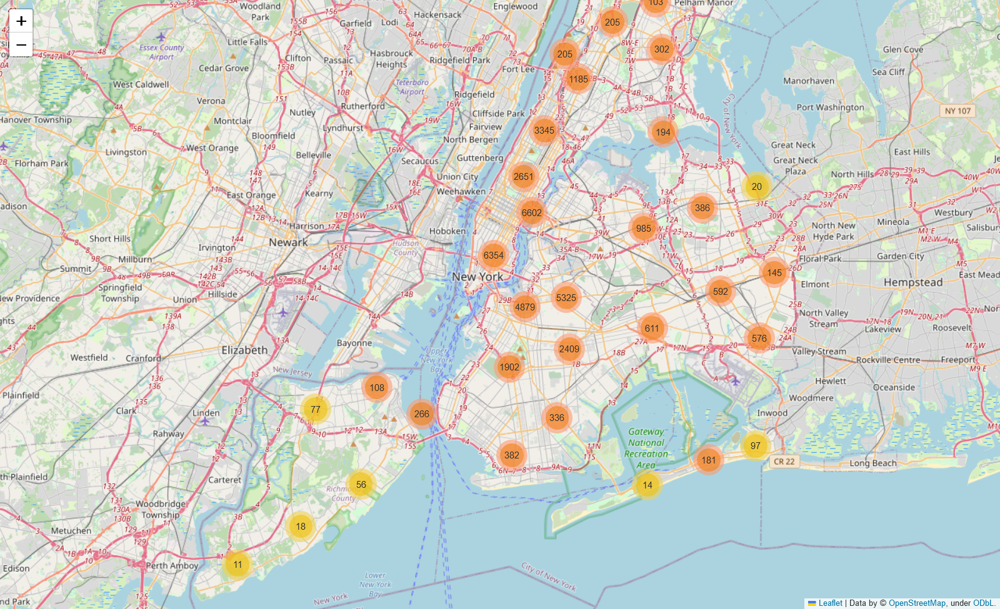

In [2]:
from folium.plugins import MarkerCluster, FastMarkerCluster #Using either is fine but I prefer FastMarkerCluster.

# Write your code below! Leave the instantiated variables: it is for your convenience.
nyc_map = folium.Map(location=[40.693943, -73.985880], zoom_start = 11)
marker_cluster = FastMarkerCluster([], name="Mean Price Cluster").add_to(nyc_map)
listings = pd.read_csv("listings.csv")
grouped_data = listings.groupby(['latitude', 'longitude'])['price'].mean().reset_index()

for index, row in grouped_data.iterrows():
    folium.Marker(location=[row['latitude'], row['longitude']],
                  popup=f"Mean Price: ${row['price']:.2f}").add_to(marker_cluster)

nyc_map.save('test.html')

convert_map_to_png(nyc_map, 'problem1a')

b) Plot a bar chart of the average price per neighbourhood group. Briefly comment on the relation between the price and neighbourhood group (use your map to analyze it). - (2.5 pts)

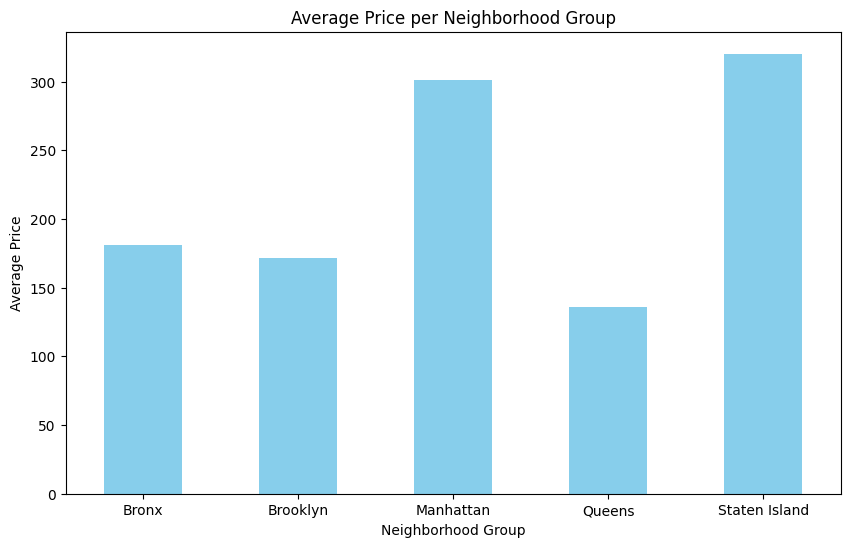

In [3]:
import matplotlib.pyplot as plt

average_price_by_neighborhood = listings.groupby('neighbourhood_group')['price'].mean()

plt.figure(figsize=(10, 6))
average_price_by_neighborhood.plot(kind='bar', color='skyblue')
plt.title('Average Price per Neighborhood Group')
plt.xlabel('Neighborhood Group')
plt.ylabel('Average Price')
plt.xticks(rotation=0)
plt.show()

Staten Island and Manhattan have significantly higher prices than the other neighborhoods. So, according to the map, neighborhoods west of the East River, have higher prices.

c) You're going to be living in New York City long term so you'd like to find places you can stay that are at minimum 300 days (inclusive). Plot a map that displays all the locations of these places. (Note: some could be in the same location) - (5 pts)


C:\Users\munir\AppData\Local\Temp\ipykernel_84152\1634010867.py:4: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  listings = pd.read_csv("listings.csv")


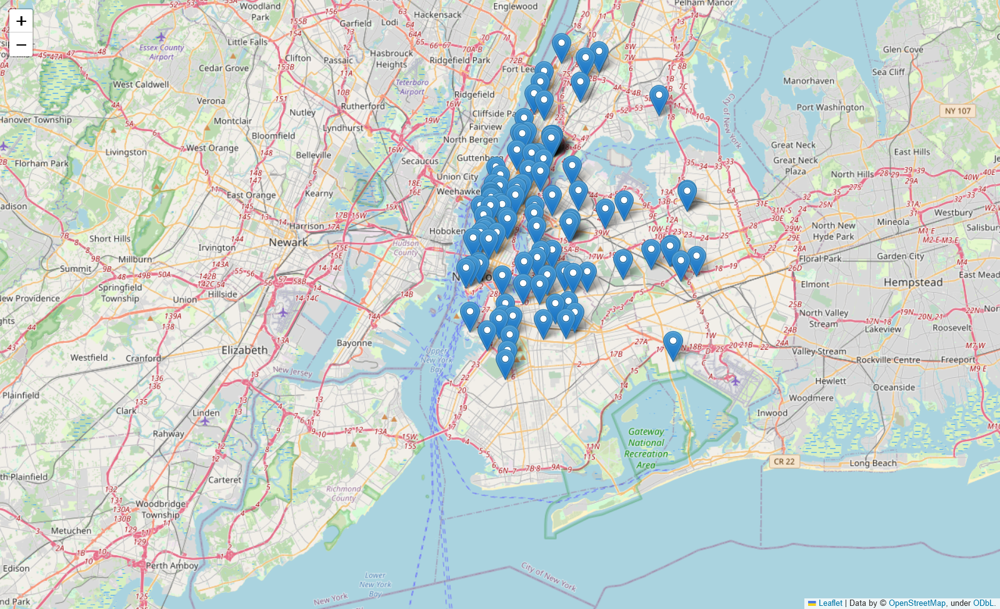

In [2]:
# Write your code below! Leave the instantiated variables: it is for your convenience.
nyc_map_2 = folium.Map(location=[40.693943, -73.985880], zoom_start=11)
listings = pd.read_csv("listings.csv")
long_term_stays = listings[listings['minimum_nights'] >= 300]

for index, row in long_term_stays.iterrows():
    folium.Marker(location=[row['latitude'], row['longitude']],
                  popup=f"Minimum stay: {row['minimum_nights']} days").add_to(nyc_map_2)

nyc_map_2.save('test2.html')

convert_map_to_png(nyc_map_2, 'problem1c')

d) Using `longitude`, `latitude`, `price`, and `number_of_reviews`, use Density-based clustering to create clusters. Plot the points on the NYC map in a color corresponding to their cluster (color could be randomly assigned, but ensure each datapoint is colored to its associated cluster). 
For using `DBSCAN`, have the settings **`eps=0.3, min_samples=10`**. Use a `CircleMarker` with `radius=1`. Plot the clusters on the map and print the number of clusters made. - (15 pts)

Number of clusters: 628


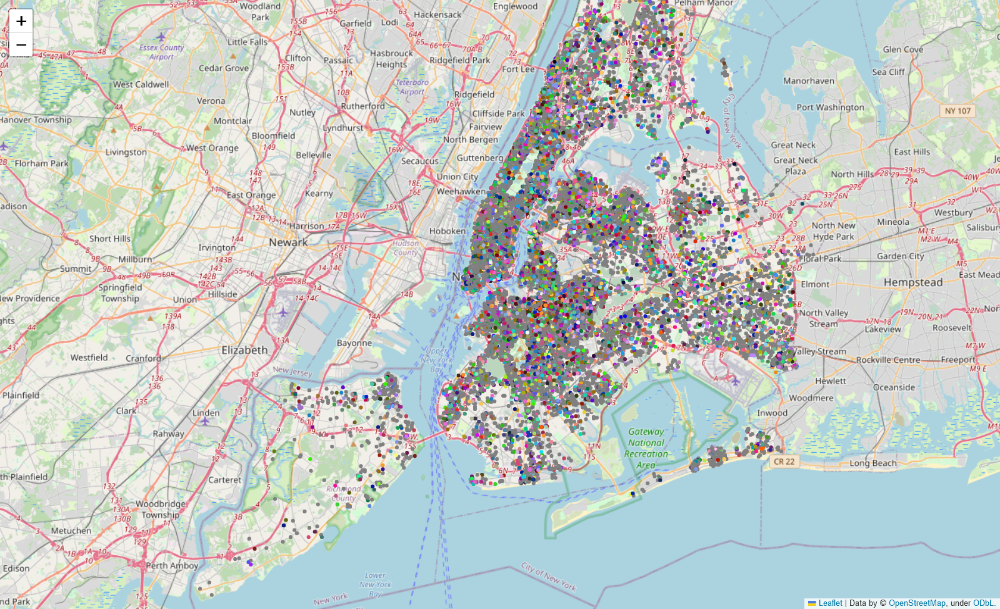

In [61]:
# Write your code below! Leave the instantiated variables: it is for your convenience.
from sklearn.cluster import DBSCAN
import random

nyc_map_3 = folium.Map(location=[40.693943, -73.985880], zoom_start=11)
listings = pd.read_csv("listings.csv", low_memory=False)
X = listings[['latitude', 'longitude', 'price', 'number_of_reviews']]
dbscan = DBSCAN(eps=0.3, min_samples=10)
listings['cluster'] = dbscan.fit_predict(X)

cluster_colors = {}
for cluster in listings['cluster'].unique():
    if cluster == -1:
        cluster_colors[cluster] = 'gray'
    else:
        cluster_colors[cluster] = "#{:02x}{:02x}{:02x}".format(random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))

for index, row in listings.iterrows():
    cluster_color = cluster_colors[row['cluster']]
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=1,
        color=cluster_color,
        fill=True,
        fill_color=cluster_color,
        fill_opacity=1
    ).add_to(nyc_map_3)

num_clusters = len(listings['cluster'].unique()) 
print(f"Number of clusters: {num_clusters}")

nyc_map_3.save('test3.html')

convert_map_to_png(nyc_map_3, 'problem1d')

e) What would happen if you were to increase/decrease `eps`, and what would happen if you were to increase/decrease `min_samples`? Give some examples when running part d (you don't have to give the map image, just say something such as "When testing part d with ... ") - (5 points)

Testing part d with a higher eps would make the neighborhood of each point larger, meaning that more points are considered part of the same cluster. As a result, you are likely to get fewer, larger clusters.  
Testing part d with a higher min_samples would require a larger number of points to form a cluster. This would result in fewer, more well-defined clusters.

f) For part d, were the clusters seemed to be scattered or grouped together? Justify your answer. - (2.5 points)

The clusters seem to be scattered as the colors are all over the place - there is no well-defined group for each color. This makes sense since we're doing DBScan on price and number of reviews, and not just the location.

g) For all listings of type `Shared room`, plot the dendrogram of the hierarchical clustering generated from `longitude`, `latitude`, and `price`. You can use any distance function. Describe your findings. - (10 points)

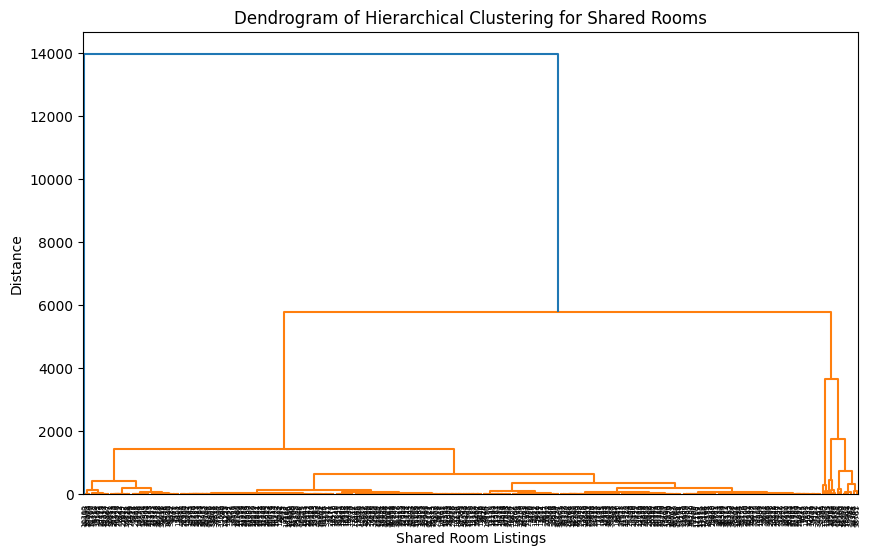

In [116]:
from scipy.cluster import hierarchy

listings = pd.read_csv("listings.csv", low_memory=False)
shared_room_listings = listings[listings['room_type'] == 'Shared room']
features = shared_room_listings[['longitude', 'latitude', 'price']]
linked = hierarchy.linkage(features, method='ward', metric='euclidean')
plt.figure(figsize=(10, 6))
hierarchy.dendrogram(linked, orientation='top', labels=shared_room_listings.index)
plt.title('Dendrogram of Hierarchical Clustering for Shared Rooms')
plt.xlabel('Shared Room Listings')
plt.ylabel('Distance')
plt.show()

There is a lot of difference in distance between the first and second divisions, making the lower-level splits hard to interpret.


h) Normalize `longitude`, `latitude`, and `price` by subtracting by the mean (of the column) and dividing by the standard deviation (of the column). Repeat g) using the normalized data. Comment on what you observe. - (5 points)

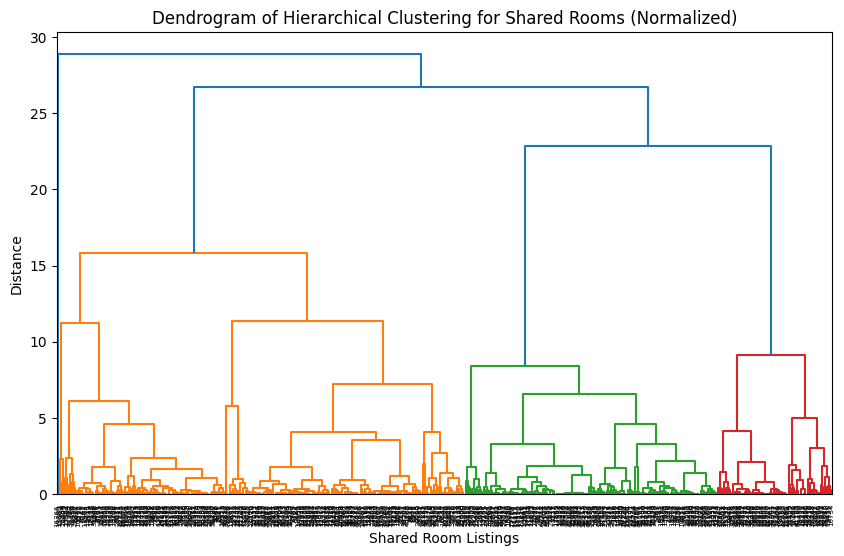

In [117]:
normalized_features = (features - features.mean()) / features.std()
linked = hierarchy.linkage(normalized_features, method='ward', metric='euclidean')
plt.figure(figsize=(10, 6))
hierarchy.dendrogram(linked, orientation='top', labels=shared_room_listings.index)
plt.title('Dendrogram of Hierarchical Clustering for Shared Rooms (Normalized)')
plt.xlabel('Shared Room Listings')
plt.ylabel('Distance')
plt.show()

By using normalized features, the algorithm was able to give similar weight to each feature, resulting in more accurate and reliable clusters.

## Exercise 2 (50 points)

a) Fetch the "mnist_784" data and store is as a `.csv` (that way you don't have to fetch it every time - which takes about 30s). (2.5 points)

In [4]:
import matplotlib.pyplot as plt

from sklearn.datasets import fetch_openml

X, y = fetch_openml(name="mnist_784", version=1, return_X_y=True, as_frame=False)

# your code here
data = pd.DataFrame(X)
data['label'] = y
data.to_csv('mnist_784.csv', index=False)

c:\Users\munir\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\datasets\_openml.py:1022: FutureWarning: The default value of `parser` will change from `'liac-arff'` to `'auto'` in 1.4. You can set `parser='auto'` to silence this warning. Therefore, an `ImportError` will be raised from 1.4 if the dataset is dense and pandas is not installed. Note that the pandas parser may return different data types. See the Notes Section in fetch_openml's API doc for details.
  warn(


b) Plot the singular value plot for a single example of the 9 digit (2.5 points)

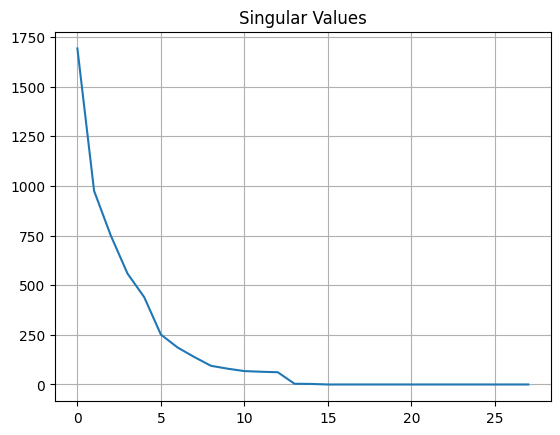

In [5]:
df = pd.read_csv("mnist_784.csv")
digit = df.loc[df['label'] == 9].head(1).values[0, :-1]
u, s, vt = np.linalg.svd(digit.reshape(28, 28), full_matrices=False)
plt.plot(s)
plt.title("Singular Values")
plt.grid(True)
plt.show()

c) Just like we did in class with the image of the boat: By setting some singular values to 0, plot the approximation of an image of a 9 digit next to the original image. (5 points)

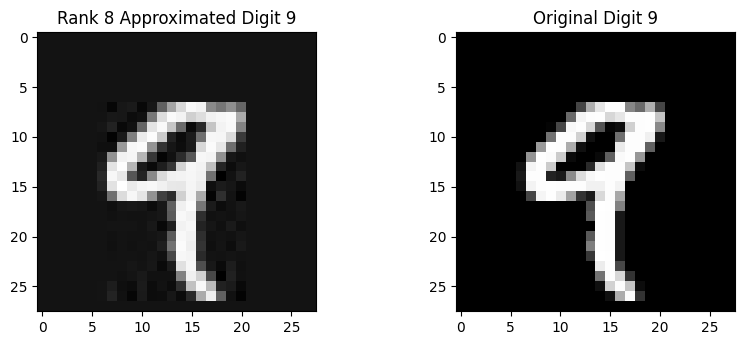

In [7]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

scopy = s.copy()
k = 8 # chose this because it appears to be the "elbow" point from the plot above
scopy[k:] = 0.0
digit_app = u.dot(np.diag(scopy)).dot(vt)

plt.figure(figsize=(9, 6))
plt.subplot(1, 2, 1)
plt.imshow(digit_app.reshape(28, 28), cmap=cm.Greys_r)
plt.title("Rank " + str(k) + " Approximated Digit 9")
plt.subplot(1, 2, 2)
plt.imshow(digit.reshape(28, 28), cmap=cm.Greys_r)
plt.title("Original Digit 9")
_ = plt.subplots_adjust(wspace=0.5)
plt.show()

d) Consider the entire dataset as a matrix. Perform SVD and explain why / how you chose a particular rank. Note: you may not be able to run this on the entire dataset in a reasonable amount of time so you may take a small random sample for this and the following questions. (5 points)

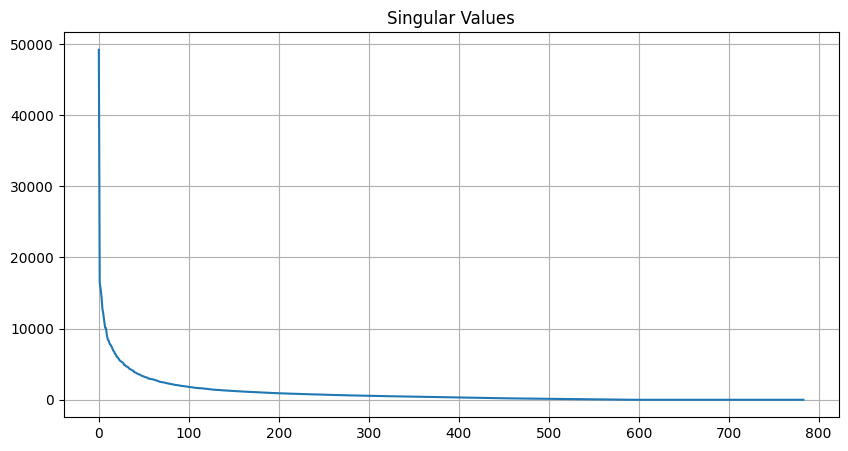

In [92]:
mnist_data = pd.read_csv('mnist_784.csv')
sample_data = mnist_data.sample(n=1000, random_state=1).drop(columns=['label'])
u, s, vt = np.linalg.svd(sample_data, full_matrices=False)
plt.figure(figsize=(10, 5))
plt.plot(s)
plt.title("Singular Values")
plt.grid(True)
plt.show()

Rank = 50, as it is near the "elbow" point

e) Plot the first 10 singular vectors. Notice that each singular vector's length will be 784 so you can plot them as a 28x28 image. (5points)

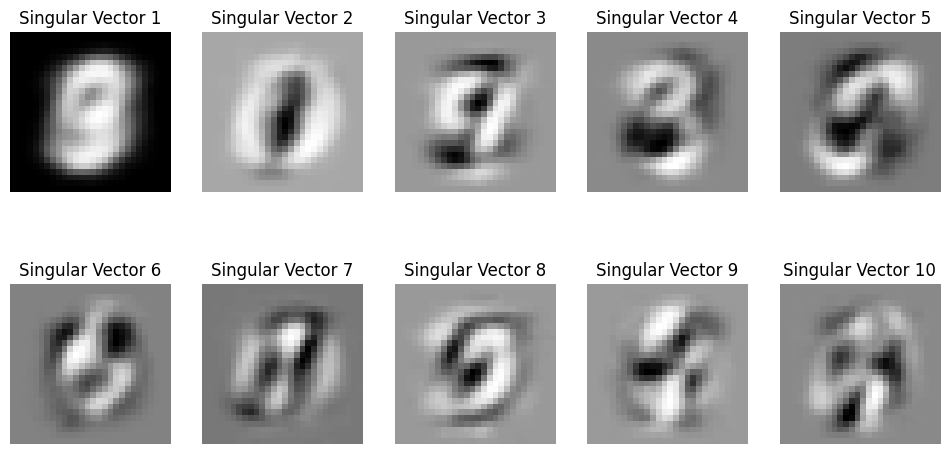

In [93]:
plt.figure(figsize=(12, 6))
for i in range(10):
    plt.subplot(2, 5, i + 1)
    singular_vector = vt[i].reshape(28,28)
    plt.imshow(singular_vector, cmap=cm.Greys_r)
    plt.title(f"Singular Vector {i+1}")
    plt.axis('off')
plt.show()

f) Using Kmeans on this new dataset, cluster the images from d) using 10 clusters and plot the centroid of each cluster. Note: the centroids should be represented as images. (10 points)

c:\Users\munir\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


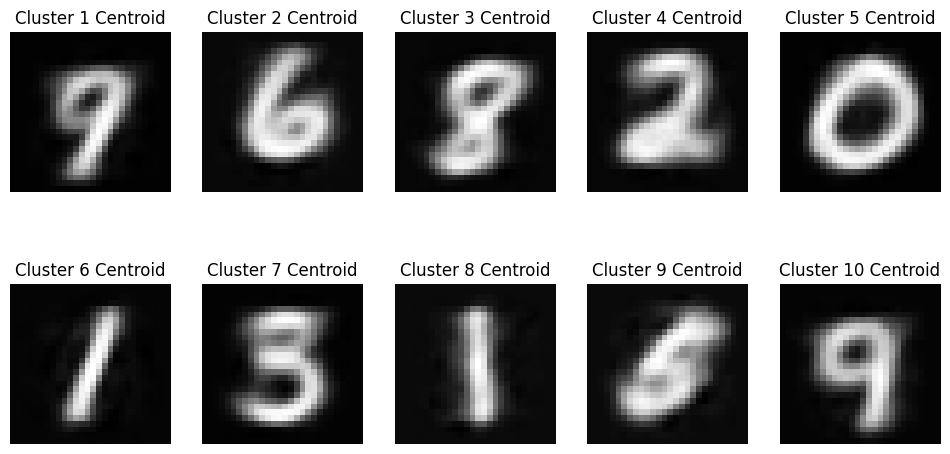

In [94]:
from sklearn.cluster import KMeans

scopy2 = s.copy()
scopy2[50:] = 0.0
sample_app = u.dot(np.diag(scopy2)).dot(vt)
n_clusters = 10
kmeans = KMeans(n_clusters=n_clusters, random_state=1)
sample_data_2 = sample_data.copy()
sample_data_2['cluster'] = kmeans.fit_predict(sample_app)
centroids = kmeans.cluster_centers_

plt.figure(figsize=(12, 6))
for i in range(n_clusters):
    plt.subplot(2, 5, i + 1)
    cluster_centroid = centroids[i].reshape(28, 28)
    plt.imshow(cluster_centroid, cmap=cm.Greys_r)
    plt.title(f'Cluster {i+1} Centroid')
    plt.axis('off')
plt.show()

g) Repeat f) on the original dataset (if you used a subset of the dataset, keep using that same subset). Comment on any differences (or lack thereof) you observe between the centroids. (5 points)

c:\Users\munir\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


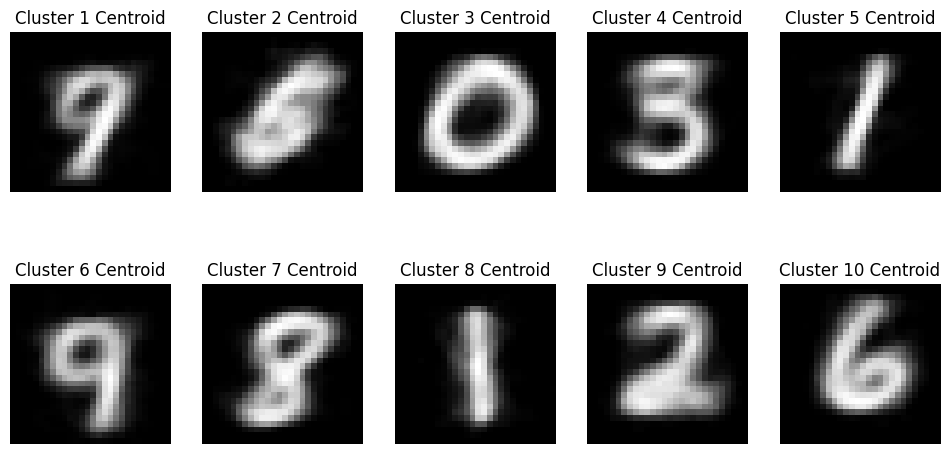

In [95]:
n_clusters = 10
kmeans = KMeans(n_clusters=n_clusters, random_state=1)
sample_data_3 = sample_data.copy()
sample_data_3['cluster'] = kmeans.fit_predict(sample_data)
centroids = kmeans.cluster_centers_

plt.figure(figsize=(12, 6))
for i in range(n_clusters):
    plt.subplot(2, 5, i + 1)
    cluster_centroid = centroids[i].reshape(28, 28)
    plt.imshow(cluster_centroid, cmap=cm.Greys_r)
    plt.title(f'Cluster {i+1} Centroid')
    plt.axis('off')
plt.show()

The centroids seem very similar, as we chose rank 50, which yields a good approximation.

h) Create a matrix (let's call it `O`) that is the difference between the original dataset and the rank-10 approximation of the dataset. (5 points)

In [96]:
scopy3 = s.copy()
scopy3[10:] = 0.0
rank_10_app = u.dot(np.diag(scopy3)).dot(vt)
X = sample_data.values
O = X - rank_10_app

i) The largest (using euclidean distance from the origin) rows of the matrix `O` could be considered anomalous data points. Briefly explain why. Plot the 10 images responsible for the 10 largest rows of that matrix `O`. (10 points)

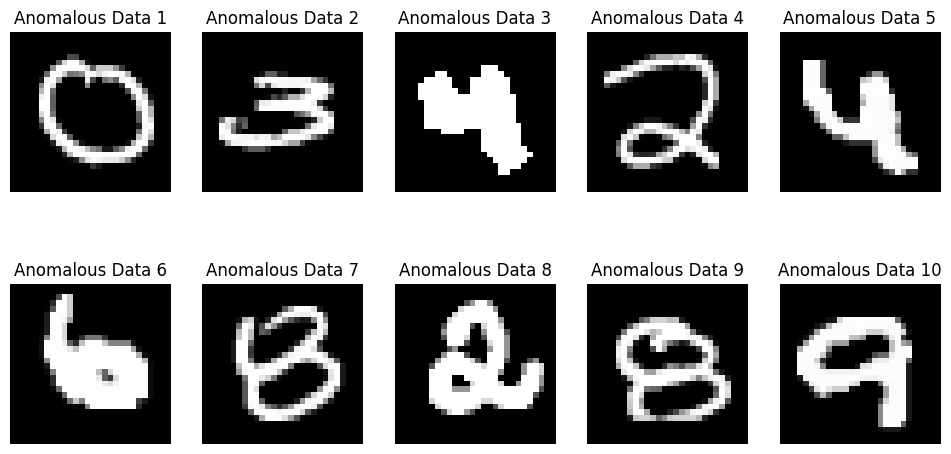

In [97]:
row_distances = np.linalg.norm(O, axis=1)
largest_indices = np.argsort(row_distances)[-10:]

plt.figure(figsize=(12, 6))
for i, idx in enumerate(largest_indices):
    plt.subplot(2, 5, i + 1)
    anomaly_image = X[idx].reshape(28, 28)
    plt.imshow(anomaly_image, cmap=cm.Greys_r)
    plt.title(f'Anomalous Data {i+1}')
    plt.axis('off')
plt.show()

The largest rows of the matrix O represent data points whose reconstructed counterparts in the rank-10 approximation differ the most from the original data points in terms of Euclidean distance from the origin. These data points can be considered anomalous because they deviate significantly from the main patterns captured by the low-rank approximation. In other words, they are outliers in the context of the rank-10 approximation, as their original counterparts are exceptionally far from the approximated subspace.

## Bonus (20pts)

Re-using the dbscan code written in class, reproduce the following animation of the dbscan algorithm

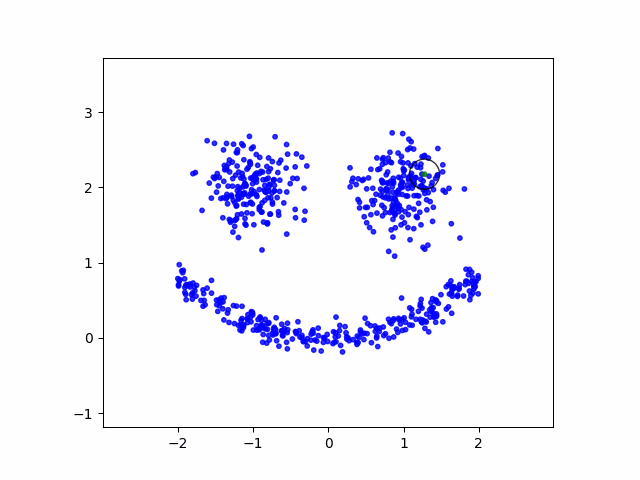

In [47]:
from IPython.display import Image
Image(filename="dbscan.gif", width=500, height=500)

Hints:

- First animate the dbscan algorithm for the dataset used in class (before trying to create the above dataset)
- Take a snapshot of the assignments when the point gets assigned to a cluster
- Confirm that the snapshot works by saving it to a file
- Don't forget to close the matplotlib plot after saving the figure
- Gather the snapshots in a list of images that you can then save as a gif using the code below
- Use `ax.set_aspect('equal')` so that the circles don't appear to be oval shaped
- To create the above dataset you need two blobs for the eyes. For the mouth you can use the following process to generate (x, y) pairs:
  - Pick an x at random in an interval that makes sense given where the eyes are positioned
  - For that x generate y that is 0.2 * x^2 plus a small amount of randomness
  - `zip` the x's and y's together and append them to the dataset containing the blobs



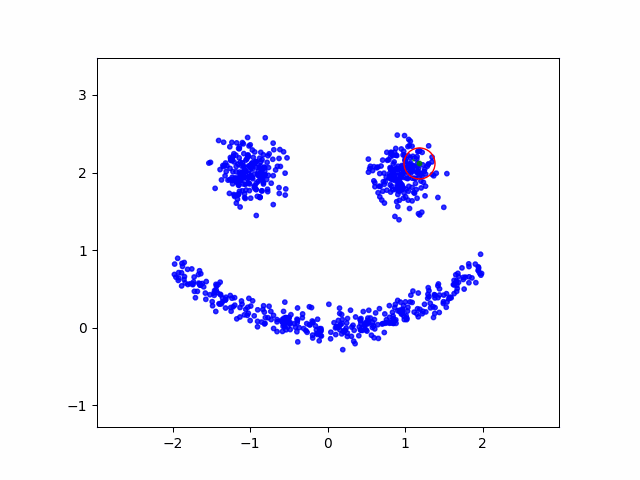

In [115]:
import numpy as np
from PIL import Image as im
import matplotlib.pyplot as plt
import sklearn.datasets as datasets

TEMPFILE = 'temp.png'

class DBC():
    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts
        self.epsilon = epsilon
        self.assignments = [0 for _ in range(len(self.dataset))]
        self.snaps = []

    def snapshot(self, current_point):
        fig, ax = plt.subplots()
        colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk'])
        colors = np.hstack([colors] * 20)
        ax.scatter(self.dataset[:, 0], self.dataset[:, 1], color=colors[self.assignments].tolist(), s=10, alpha=0.8)
        cir = plt.Circle(self.dataset[current_point], self.epsilon, color='red', fill=False)
        ax.add_patch(cir)
        ax.set_xlim(self.dataset[:, 0].min() - 1, self.dataset[:, 0].max() + 1)
        ax.set_ylim(self.dataset[:, 1].min() - 1, self.dataset[:, 1].max() + 1)
        ax.set_aspect('equal')
        fig.savefig(TEMPFILE)
        plt.close()
        self.snaps.append(im.fromarray(np.asarray(im.open(TEMPFILE))))

    def distance(self, i, j):
        return np.linalg.norm(self.dataset[i] - self.dataset[j])

    def get_neighborhood(self, i):
        neighborhood = []
        for j in range(len(self.dataset)):
            if self.distance(i, j) <= self.epsilon and i != j:
                neighborhood.append(j)
        return neighborhood

    def is_core(self, i):
        return len(self.get_neighborhood(i)) >= self.min_pts

    def assign(self, i, cluster_num):
        self.assignments[i] = cluster_num
        neighbor_queue = self.get_neighborhood(i)
        while neighbor_queue:
            next_candidate = neighbor_queue.pop()
            if self.assignments[next_candidate] != 0:
                continue
            self.assignments[next_candidate] = cluster_num
            self.snapshot(next_candidate)
            if self.is_core(next_candidate):
                next_neighborhood = self.get_neighborhood(next_candidate)
                neighbor_queue += [i for i in next_neighborhood if self.assignments[i] == 0]
        return

    def dbscan(self):
        cluster_num = 1
        for i in range(len(self.dataset)):
            if self.is_core(i) and self.assignments[i] == 0:
                self.assign(i, cluster_num)
                cluster_num += 1
        return self.assignments

centers = [[-1, 2], [1, 2]]
eyes, _ = datasets.make_blobs(n_samples=400, centers=centers, cluster_std=0.2, random_state=0)

mouth_x =  -2 + 4 * np.random.random(350)
mouth_y = 0.2 * mouth_x**2 + 0.1 * np.random.randn(350)

face = np.append(eyes, list(zip(mouth_x, mouth_y)), axis=0)

dbc = DBC(face, 3, 0.2)
clustering = dbc.dbscan()

dbc.snaps[0].save(
    'dbscan1.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=25
)

Image(filename="dbscan1.gif", width=500, height=500)